In [4]:
from rdkit import Chem
from rdkit.Chem import Draw
import pandas as pd

# 加载包含SMILES序列的文件
data = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/ana/resample/resample_rabbit.csv')

# 选择要可视化的SMILES列
smiles_column = 'SMILES'  # 或者 'Canonical_Smiles.1'，取决于你的需求

# 设置分子图像的尺寸和其他视觉参数
img_size = (1000, 1000)  # 图像大小，单位为像素
bond_width = 2.0  # 键的线宽
font_size = 0.5  # 原子标签的字体大小，相对于图像大小的比例

options = Draw.DrawingOptions()
options.bondLineWidth = int(bond_width)
options.atomLabelFontSize = int(img_size[0] * font_size)
options.includeAtomNumbers = True  # 如果不想显示原子编号，设置为False

# 为每个SMILES序列生成分子对象，并绘制分子图像
for i, smiles in enumerate(data[smiles_column]):
    molecule = Chem.MolFromSmiles(smiles)
    img = Draw.MolToImage(molecule, size=img_size, options=options)
    
    # 将每个分子的图像保存到文件
    img.save('/home/dell/mxq/toxic_mol/model/MS2/ana/resample/resample_graph/rabbit/'+f'molecule_{i}.png')


[20:46:23] WARNING: not removing hydrogen atom without neighbors


In [12]:
from rdkit import Chem
from rdkit.Chem import Draw
import pandas as pd

# 加载包含SMILES序列的文件
data = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/ana/resample/resample_rabbit.csv')
# 选择要可视化的SMILES列
smiles_column = 'SMILES'  # 或者 'Canonical_Smiles.1'，取决于你的需求
# 设置分子图像的尺寸和其他视觉参数
img_size = (2000, 1000)  # 图像大小，单位为像素
bond_width = 4  # 键的线宽
font_size = 4  # 原子标签的字体大小，相对于图像大小的比例
options = Draw.DrawingOptions()
options.bondLineWidth = int(bond_width)
options.atomLabelFontSize = int(img_size[0] * font_size)
options.includeAtomNumbers = False  # 如果不想显示原子编号，设置为False
molecule = Chem.MolFromSmiles('COc1ccc(\C=C\C)cc1OC')
img = Draw.MolToImage(molecule, size=img_size, options=options)   
# 将每个分子的图像保存到文件
img.save('/home/dell/mxq/toxic_mol/model/MS2/ana/resample/resample_graph/rabbit/'+f'molecule_34.png')

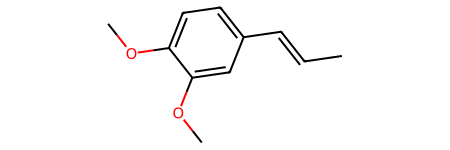

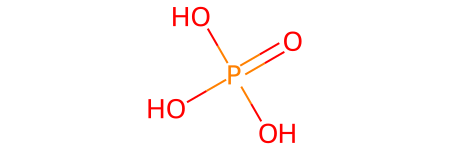

In [1]:
from rdkit import Chem
smiles = 'OP(=O)(O)O'  # 示例：乙醇的SMILES序列
molecule = Chem.MolFromSmiles(smiles)
molecule

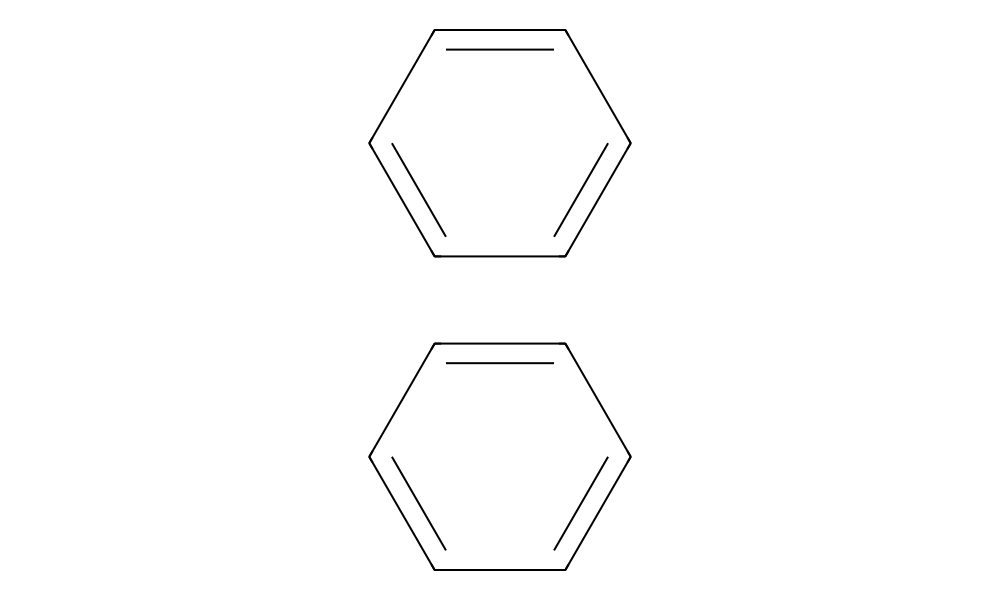

In [3]:
from rdkit import Chem
from rdkit.Chem import Draw

smiles = 'c1ccccc1.c1ccccc1'  # Example SMILES for a molecule
molecule = Chem.MolFromSmiles(smiles)

# Generate a high-quality image of the molecule with thicker bonds
img = Draw.MolToImage(molecule, size=(1000, 600), bw=20)  # size for high-quality, bw for bond width

# To display the image in a Jupyter notebook, simply output `img`.
# To save the image to a file, use img.save('molecule_image.png')
img

In [21]:
from rdkit import Chem
from rdkit.Chem import Draw

smiles = 'COc1ccc(\\C=C\\C)cc1OC'  # Example SMILES for a molecule
molecule = Chem.MolFromSmiles(smiles)

# Create a drawing options object
options = Draw.rdMolDraw2D.MolDrawOptions()
options.bondLineWidth = 20  # Adjust the bond line width as needed
options.minFontSize=80
# Generate a high-quality image with customized drawing options
drawer = Draw.MolDraw2DCairo(2000, 2000)  # Specify the image size
drawer.SetDrawOptions(options)
drawer.DrawMolecule(molecule)
drawer.FinishDrawing()

# Save the image to a file
with open("molecule_image.png", "wb") as f:
    f.write(drawer.GetDrawingText())


In [23]:
from rdkit import Chem
from rdkit.Chem import Draw

smiles = 'COc1ccc(\\C=C\\C)cc1OC'  # Example SMILES for a molecule
molecule = Chem.MolFromSmiles(smiles)

# Create a drawing options object
options = Draw.rdMolDraw2D.MolDrawOptions()
options.bondLineWidth = 20  # Thicker bond lines
options.minFontSize = 80    # Larger font size for atom labels
options.useBWAtomPalette = False  # Use color for atoms

# Generate a high-quality image with customized drawing options
drawer = Draw.MolDraw2DCairo(2000, 2000)  # High resolution for clarity
drawer.SetDrawOptions(options)
drawer.DrawMolecule(molecule)
drawer.FinishDrawing()

# Save the image to a file
output_path = "molecule_image.png"
with open(output_path, "wb") as f:
    f.write(drawer.GetDrawingText())

# Print the path to the output image
print(f"Molecule image saved to: {output_path}")


Molecule image saved to: molecule_image.png


### 对于采样和非采样的数据集进行pca分析

In [22]:
##读取rabbit数据
import pandas as pd
rabbit_nonsample = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/split/train_dataset.csv')
rabbit_sample=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/split/train_resample.csv')
rat_nonsample = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/split/train_dataset.csv')
rat_sample=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/split/train_resample.csv')

In [23]:
rabbit_sample_list=rabbit_sample['Canonical_Smiles'].tolist()
rabbit_nonsample_list=rabbit_nonsample['Canonical_Smiles'].tolist()
rat_sample_list=rat_sample['SMILES'].tolist()
rat_nonsample_list=rat_nonsample['SMILES'].tolist()

### rabbit PCA analysis

In [24]:
from rdkit import Chem
from rdkit.Chem import MACCSkeys
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import numpy as np

# 定义一个函数来从SMILES字符串计算MACCS指纹
def compute_MACCS(smiles):
    mol = Chem.MolFromSmiles(smiles)
    return np.array(MACCSkeys.GenMACCSKeys(mol))

# # 假设我们有一个SMILES字符串的列表
# smiles_list = ['CCO', 'CCOCC', 'CCN(CC)CC', 'CC(C)C(=O)O', 'c1ccccc1']

# 计算每个分子的MACCS指纹
fingerprints_sample = np.array([compute_MACCS(smiles) for smiles in rabbit_sample_list])
fingerprints_nonsample=np.array([compute_MACCS(smiles) for smiles in rabbit_nonsample_list])
# 由于MACCS指纹是二进制的（0或1），所以可以选择是否进行标准化
# 在这个示例中，我们将直接应用PCA，不进行标准化
# 如果你决定进行标准化，请取消下面三行的注释
##sample
scaler = StandardScaler()
fingerprints_scaled = scaler.fit_transform(fingerprints_sample.astype(float))
principal_components_sample = PCA(n_components=2).fit_transform(fingerprints_scaled)
# 应用PCA
pca = PCA(n_components=2)  # 降到2维
# principal_components = pca.fit_transform(fingerprints)
# 打印降维后的数据
print('sample:',principal_components_sample)

##non——sample
# scaler = StandardScaler()
fingerprints_scaled = scaler.fit_transform(fingerprints_nonsample.astype(float))
principal_components_nonsample = PCA(n_components=2).fit_transform(fingerprints_scaled)
# 应用PCA
pca = PCA(n_components=2)  # 降到2维
print('nonsample:',principal_components_nonsample)

[20:47:41] WARNING: not removing hydrogen atom without neighbors
[20:47:41] WARNING: not removing hydrogen atom without neighbors


sample: [[ 5.17588971 -1.09124916]
 [-1.03844953 -0.84631952]
 [-3.31570576  0.67084488]
 ...
 [ 8.43321567 -0.76796853]
 [-1.67612751  1.40891173]
 [ 2.27074519 -4.81501345]]
nonsample: [[-4.4166481   0.86833728]
 [ 4.51003378 -2.76240734]
 [ 8.18806489 -4.0920756 ]
 ...
 [-4.44594153  2.14317162]
 [-1.58022043  0.77109897]
 [ 2.91598348 -3.856624  ]]


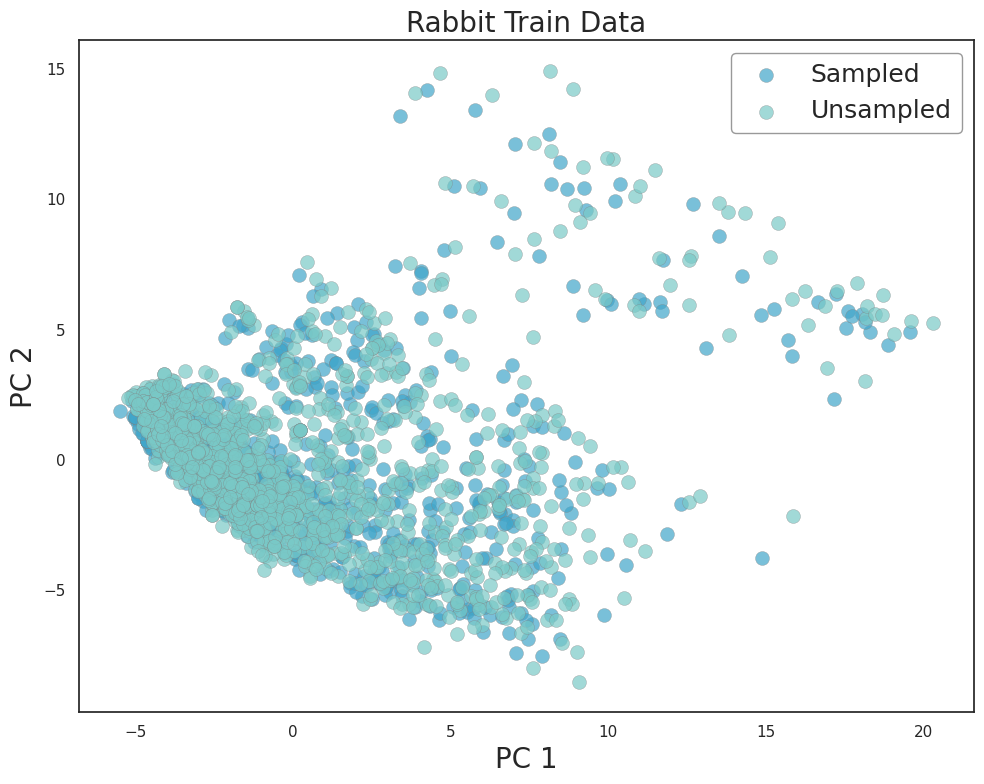

'PCA_for_rabbit1.png'

In [26]:
import matplotlib.pyplot as plt
# To save a high-resolution version of the plot, we can specify the 'dpi' (dots per inch) parameter in the savefig method.
# User-specified colors
color_sampled = '#41A6CA'  # A shade of green
color_unsampled = '#79C9C7'  # A lighter shade of green
# Start creating the figure with the user-specified colors and high DPI for high resolution
plt.figure(figsize=(10, 8),facecolor='white')
# Set the axis background color
plt.gca().set_facecolor('white')
# Plotting with the user-specified colors and refined aesthetics
plt.scatter(principal_components_sample[:, 0], principal_components_sample[:, 1], 
            s=100, alpha=0.7, color=color_sampled, edgecolor='grey', linewidth=0.3, label='Sampled')

plt.scatter(principal_components_nonsample[:, 0], principal_components_nonsample[:, 1], 
            s=100, alpha=0.7, color=color_unsampled, edgecolor='grey', linewidth=0.3, label='Unsampled')
# Updating legend to match the color changes
legend = plt.legend(frameon = 1, loc='upper right',fontsize=18)
frame = legend.get_frame()
frame.set_color('white')
frame.set_edgecolor('grey')

# Add labels and title with a professional appearance
plt.xlabel('PC 1', fontsize=20)
plt.ylabel('PC 2', fontsize=20)
plt.title('Rabbit Train Data', fontsize=20)

# Customize the grid for better appearance
# plt.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
plt.grid(False)
# plt.xticks(fontsize=13)
# plt.yticks(fontsize=13)
# Tight layout for better spacing
plt.tight_layout()
# Save the plot to a file with the new colors and high DPI
optimized_plot_path_high_res = 'PCA_for_rabbit1.png'
plt.savefig(optimized_plot_path_high_res, dpi=800,facecolor='white')  # 300 dpi is often used for high-resolution images
plt.savefig('PCA_for_rabbit1.svg')
# Show the plot in this notebook as well (will not display in the chat interface)
plt.show()

# Return the path to the saved plot with high resolution
optimized_plot_path_high_res



In [12]:
from rdkit import Chem
from rdkit.Chem import MACCSkeys
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import numpy as np

# 定义一个函数来从SMILES字符串计算MACCS指纹
def compute_MACCS(smiles):
    mol = Chem.MolFromSmiles(smiles)
    return np.array(MACCSkeys.GenMACCSKeys(mol))

# # 假设我们有一个SMILES字符串的列表
# smiles_list = ['CCO', 'CCOCC', 'CCN(CC)CC', 'CC(C)C(=O)O', 'c1ccccc1']

# 计算每个分子的MACCS指纹
fingerprints_sample = np.array([compute_MACCS(smiles) for smiles in rat_sample_list])
fingerprints_nonsample=np.array([compute_MACCS(smiles) for smiles in rat_nonsample_list])
# 由于MACCS指纹是二进制的（0或1），所以可以选择是否进行标准化
# 在这个示例中，我们将直接应用PCA，不进行标准化
# 如果你决定进行标准化，请取消下面三行的注释
##sample
scaler = StandardScaler()
fingerprints_scaled = scaler.fit_transform(fingerprints_sample.astype(float))
principal_components_sample = PCA(n_components=2).fit_transform(fingerprints_scaled)
# 应用PCA
pca = PCA(n_components=2)  # 降到2维
# principal_components = pca.fit_transform(fingerprints)
# 打印降维后的数据
print('sample:',principal_components_sample)

##non——sample
# scaler = StandardScaler()
fingerprints_scaled = scaler.fit_transform(fingerprints_nonsample.astype(float))
principal_components_nonsample = PCA(n_components=2).fit_transform(fingerprints_scaled)
# 应用PCA
pca = PCA(n_components=2)  # 降到2维
print('nonsample:',principal_components_nonsample)

[19:28:17] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:18] WARNING: not removing hydrogen atom without neighbors
[19:28:19] WARNING: not removing hydrogen atom without neighbors
[19:28:19] WARNING: not removing hydrogen atom without neighbors
[19:28:19] WARNING: not removing hydrogen atom without neighbors
[19:28:20] WARNING: not removing hydrogen atom without neighbors
[19:28:20] WARNING: not removing hydrogen atom without neighbors
[19:28:20] WARNING: not removing hydrogen atom without neighbors


sample: [[-2.38675604  3.39682241]
 [-3.85025047  1.35287322]
 [ 5.04656603 -1.00762355]
 ...
 [-2.28869477 -1.25913174]
 [-1.54340596 -1.24638456]
 [ 0.43530523  8.37053388]]
nonsample: [[-1.99937007  1.12316849]
 [ 1.33278063 -2.77321231]
 [ 0.33338283 -2.92848019]
 ...
 [-1.95095187 -1.17089253]
 [-1.53804435 -1.35985444]
 [ 0.28391346  8.62560862]]


[19:28:20] WARNING: not removing hydrogen atom without neighbors


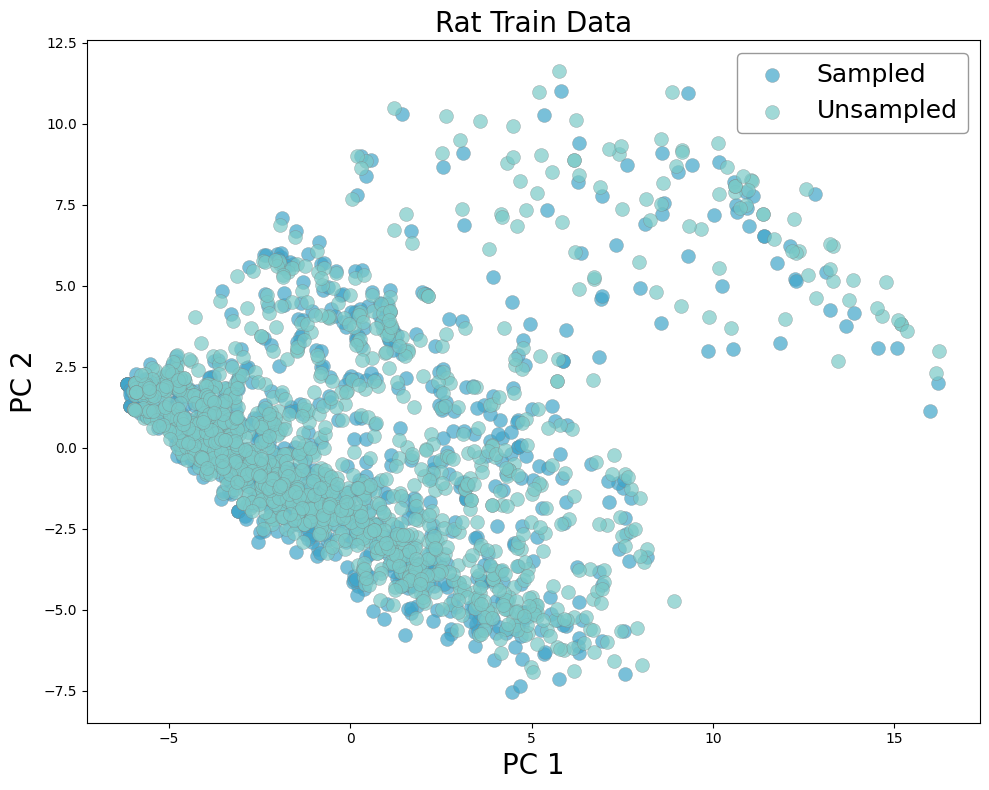

'PCA_for_rat1.png'

In [13]:
import matplotlib.pyplot as plt
# To save a high-resolution version of the plot, we can specify the 'dpi' (dots per inch) parameter in the savefig method.
# User-specified colors
color_sampled = '#41A6CA'  # A shade of green
color_unsampled = '#79C9C7'  # A lighter shade of green
# Start creating the figure with the user-specified colors and high DPI for high resolution
plt.figure(figsize=(10, 8))

# Plotting with the user-specified colors and refined aesthetics
plt.scatter(principal_components_sample[:, 0], principal_components_sample[:, 1], 
            s=100, alpha=0.7, color=color_sampled, edgecolor='grey', linewidth=0.3, label='Sampled')

plt.scatter(principal_components_nonsample[:, 0], principal_components_nonsample[:, 1], 
            s=100, alpha=0.7, color=color_unsampled, edgecolor='grey', linewidth=0.3, label='Unsampled')

# Updating legend to match the color changes
legend = plt.legend(frameon = 1, loc='upper right',fontsize=18)
frame = legend.get_frame()
frame.set_color('white')
frame.set_edgecolor('grey')

# Add labels and title with a professional appearance
plt.xlabel('PC 1', fontsize=20)
plt.ylabel('PC 2', fontsize=20)
plt.title('Rat Train Data', fontsize=20)

# Customize the grid for better appearance
# plt.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
plt.grid(False)
# Tight layout for better spacing
plt.tight_layout()

# Save the plot to a file with the new colors and high DPI
optimized_plot_path_high_res = 'PCA_for_rat1.png'
plt.savefig(optimized_plot_path_high_res, dpi=800,facecolor='white')  # 300 dpi is often used for high-resolution images
plt.savefig('PCA_for_rat1.svg')
# Show the plot in this notebook as well (will not display in the chat interface)
plt.show()

# Return the path to the saved plot with high resolution
optimized_plot_path_high_res



##### 统计Murcko框架个数

In [110]:
from rdkit import Chem
from rdkit.Chem.Scaffolds import MurckoScaffold

# 示例SMILES字符串
smiles = "CC1=C(C=C(C=C1)O)NC(=O)C2=CC=CN=C2"

# 将SMILES字符串转换为RDKit分子对象
mol = Chem.MolFromSmiles(smiles)

# 获取Murcko框架
scaffold = MurckoScaffold.GetScaffoldForMol(mol)

# 将Murcko框架转换回SMILES字符串（如果需要）
scaffold_smiles = Chem.MolToSmiles(scaffold)

print(scaffold_smiles)


O=C(Nc1ccccc1)c1cccnc1


In [128]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem.Scaffolds import MurckoScaffold

# 读取CSV文件
df = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/Rabbit.csv')  # 把 'path_to_your_csv.csv' 替换成你的CSV文件路径

# 确保SMILES列存在
assert 'SMILES' in df.columns, "CSV文件中必须有一个名为'SMILES'的列。"

# 初始化一个空的字典来存储Murcko框架
scaffold_counts = {}

# 遍历SMILES列
for smiles in df['SMILES']:
    # 将SMILES字符串转换为分子对象
    # mol = Chem.MolFromSmiles(smiles)
    # 获取Murcko框架
    scaffold_smiles = MurckoScaffold.MurckoScaffoldSmilesFromSmiles(smiles)
    # 将Murcko框架转换为SMILES字符串
    # scaffold_smiles = Chem.MolToSmiles(scaffold)
    # 统计Murcko框架
    if scaffold_smiles in scaffold_counts:
        scaffold_counts[scaffold_smiles] += 1
    else:
        scaffold_counts[scaffold_smiles] = 1

# 输出统计结果
scaffold_counts_df = pd.DataFrame(list(scaffold_counts.items()), columns=['Scaffold_SMILES', 'Count'])
scaffold_counts_df.sort_values('Count', ascending=False, inplace=True)

# 可选：保存结果到CSV文件
scaffold_counts_df.to_csv('Murcko/scaffold_counts_rabbit.csv', index=False)

scaffold_counts_df


[19:43:23] WARNING: not removing hydrogen atom without neighbors


,Scaffold_SMILES,Count
1,,687
0,c1ccccc1,378
25,C1CCCCC1,24
20,C1=CCCCC1,20
38,c1ncncn1,20
...,...,...
156,c1ccc(OCOc2ccccc2)cc1,1
157,c1ccc(P(c2ccccc2)c2ccccc2)cc1,1
161,C1=C(c2ccccc2)CCCC1,1
162,c1ccc(C2CCCCC2)cc1,1


### 基于ECP4分子指纹的相似性分析

In [14]:
import pandas as pd
# 加载数据集
rabbit = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/Rabbit.csv')
rat=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/Rat.csv')


In [15]:
rabbit_list=rabbit['SMILES'].to_list()
rat_list=rat['SMILES'].to_list()

#### rat 数据集相似性

In [16]:
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit import DataStructs
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# 假设rat_list是包含SMILES字符串的列表
# 例如：rat_list = ["C(C(=O)O)c1ccccc1", "N[C@@H](CC1=CNC2=C1C=CC=C2)C(O)=O", ...]

# 将SMILES字符串转换为分子对象，并生成ECFP4指纹
ecfp_fingerprints = [AllChem.GetMorganFingerprintAsBitVect(Chem.MolFromSmiles(smile), radius=2, nBits=2048) for smile in rat_list]

# 初始化一个空的相似度矩阵
similarity_matrix = np.zeros((len(ecfp_fingerprints), len(ecfp_fingerprints)))

# 计算每对分子之间的Tanimoto相似度
for i in range(len(ecfp_fingerprints)):
    for j in range(len(ecfp_fingerprints)):
        similarity_matrix[i, j] = DataStructs.FingerprintSimilarity(ecfp_fingerprints[i], ecfp_fingerprints[j])



# 注意：这段代码无法在PCI环境中运行，因为rdkit库不可用。你需要在你的本地环境中运行这段代码。


[19:32:20] WARNING: not removing hydrogen atom without neighbors
[19:32:20] WARNING: not removing hydrogen atom without neighbors
[19:32:20] WARNING: not removing hydrogen atom without neighbors
[19:32:20] WARNING: not removing hydrogen atom without neighbors
[19:32:20] WARNING: not removing hydrogen atom without neighbors
[19:32:21] WARNING: not removing hydrogen atom without neighbors
[19:32:21] WARNING: not removing hydrogen atom without neighbors
[19:32:21] WARNING: not removing hydrogen atom without neighbors
[19:32:21] WARNING: not removing hydrogen atom without neighbors
[19:32:21] WARNING: not removing hydrogen atom without neighbors


In [17]:
print('rat',np.mean(similarity_matrix))

rat 0.08188002069849755


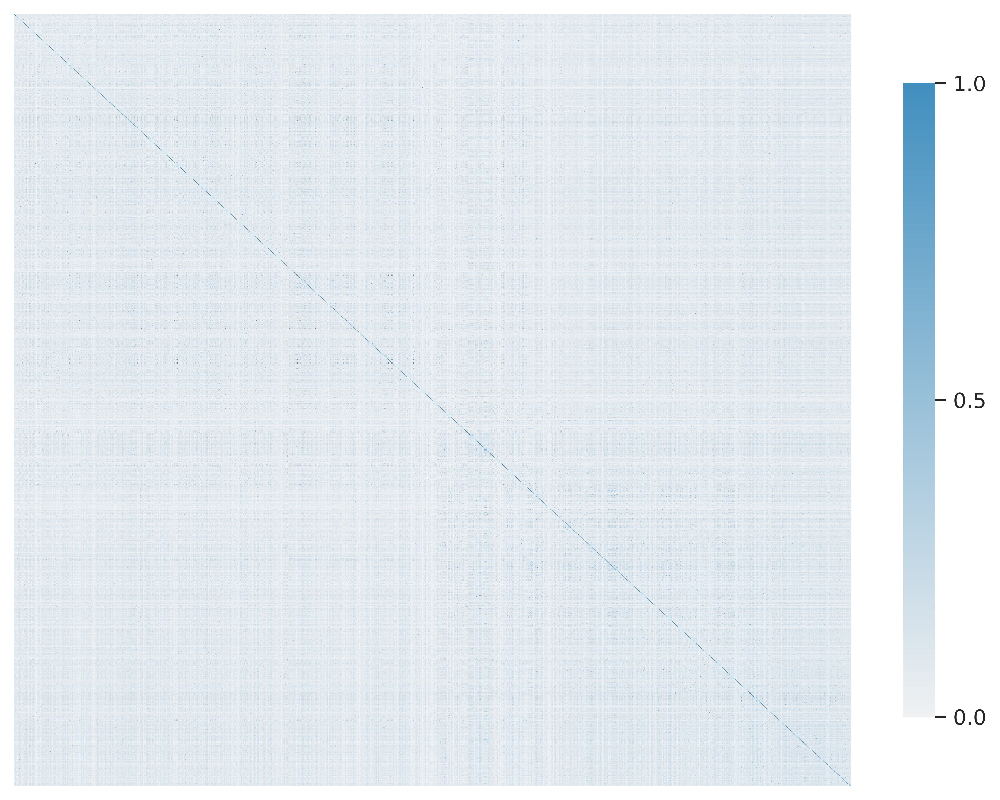

In [32]:
# Set the style to be more suitable for publication
sns.set(style="white")

# Create a custom color palette based on the light blue color you've chosen
cmap = sns.light_palette("#418FBF", as_cmap=True)

# Set the DPI (dots per inch) for higher resolution output
plt.figure(figsize=(8, 6), dpi=800)

# Create the heatmap without axis labels and ticks 'label': 'Similarity'
ax = sns.heatmap(similarity_matrix, annot=False, cmap=cmap, cbar=True,
                 cbar_kws={"shrink": .82, 'ticks' : [0, 0.5, 1]},
                 linewidths=0, linecolor='blue')
# Set the title and adjust its position and font size
# plt.title('Rat Tanimoto Similarity', fontsize=18, y=1.05)

# Remove axis labels
plt.xlabel('')
plt.ylabel('')

# Remove axis ticks
plt.xticks([])
plt.yticks([])

# Adjust layout for tight fit
plt.tight_layout()

# Save the figure with a high DPI setting to increase image clarity
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/Tanimoto Similarity/rat_heatmap1.png', dpi=800, bbox_inches='tight',transparent=True)
# plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/Tanimoto Similarity/rat_heatmap1.svg')
# Display the heatmap
plt.show()


#### rabbit 相似性计算

In [33]:
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit import DataStructs
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# 假设rat_list是包含SMILES字符串的列表
# 例如：rat_list = ["C(C(=O)O)c1ccccc1", "N[C@@H](CC1=CNC2=C1C=CC=C2)C(O)=O", ...]

# 将SMILES字符串转换为分子对象，并生成ECFP4指纹
ecfp_fingerprints = [AllChem.GetMorganFingerprintAsBitVect(Chem.MolFromSmiles(smile), radius=2, nBits=2048) for smile in rabbit_list]

# 初始化一个空的相似度矩阵
similarity_matrix = np.zeros((len(ecfp_fingerprints), len(ecfp_fingerprints)))

# 计算每对分子之间的Tanimoto相似度
for i in range(len(ecfp_fingerprints)):
    for j in range(len(ecfp_fingerprints)):
        similarity_matrix[i, j] = DataStructs.FingerprintSimilarity(ecfp_fingerprints[i], ecfp_fingerprints[j])



# 注意：这段代码无法在PCI环境中运行，因为rdkit库不可用。你需要在你的本地环境中运行这段代码。


[21:07:38] WARNING: not removing hydrogen atom without neighbors


In [34]:
print('rabbit',np.mean(similarity_matrix))

rabbit 0.08579155585823842


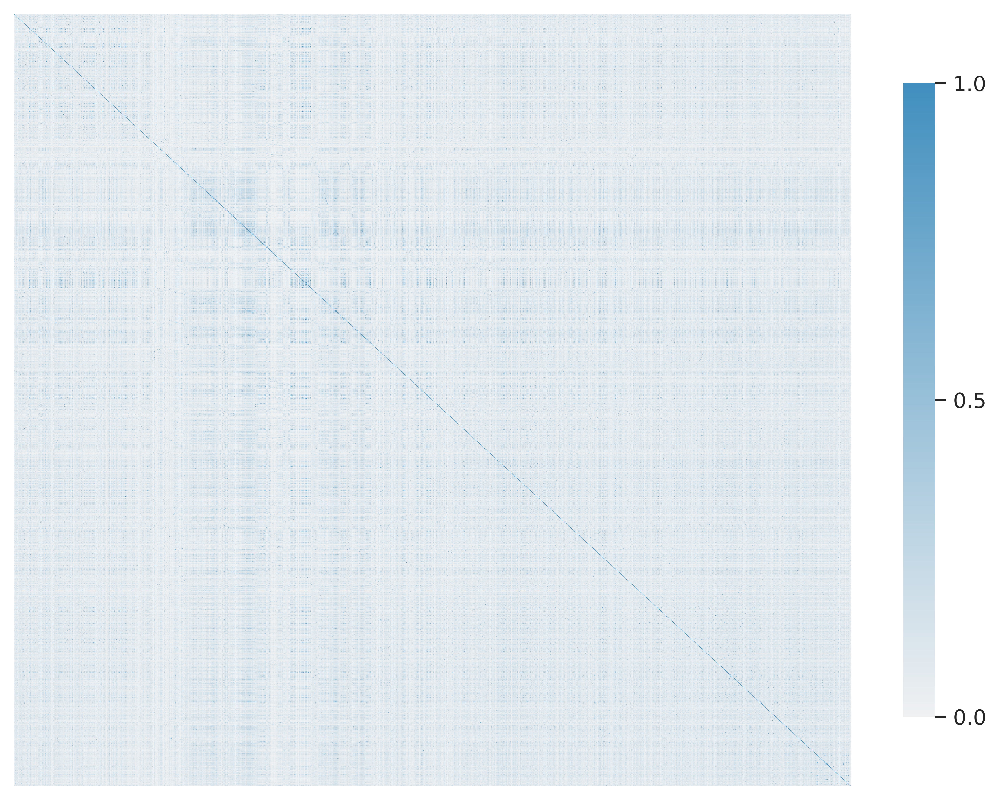

In [35]:
# Set the style to be more suitable for publication
sns.set(style="white")

# Create a custom color palette based on the light blue color you've chosen
cmap = sns.light_palette("#418FBF", as_cmap=True)

# Set the DPI (dots per inch) for higher resolution output
plt.figure(figsize=(8, 6), dpi=800)

# Create the heatmap without axis labels and ticks
ax = sns.heatmap(similarity_matrix, annot=False, cmap=cmap, cbar=True,
                 cbar_kws={"shrink": .82, 'ticks' : [0, 0.5, 1],},
                 linewidths=0, linecolor='blue')

# Set the title and adjust its position and font size
# plt.title('Rabbit Tanimoto Similarity', fontsize=18, y=1.05)
# Remove axis labels
plt.xlabel('')
plt.ylabel('')
# Remove axis ticks
plt.xticks([])
plt.yticks([])
# Adjust layout for tight fit
plt.tight_layout()
# Save the figure with a high DPI setting to increase image clarity
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/Tanimoto Similarity/rabbit_heatmap1.png', dpi=800, bbox_inches='tight',transparent=True)
# Display the heatmap
plt.show()


#### 训练集 测试集和外部验证集的三维pca分析

##### rabbit数据读取

In [37]:
a = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/split/train_resample.csv')
b=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/split/test_dataset.csv')
c=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rabbit/split/Rabbit_external.csv')

In [39]:
train_smiles=a['Canonical_Smiles'].to_list()
test_smiles=b['Canonical_Smiles'].to_list()
external_smiles=c['Canonical_Smiles'].to_list()

[06:01:58] WARNING: not removing hydrogen atom without neighbors
[06:01:58] WARNING: not removing hydrogen atom without neighbors


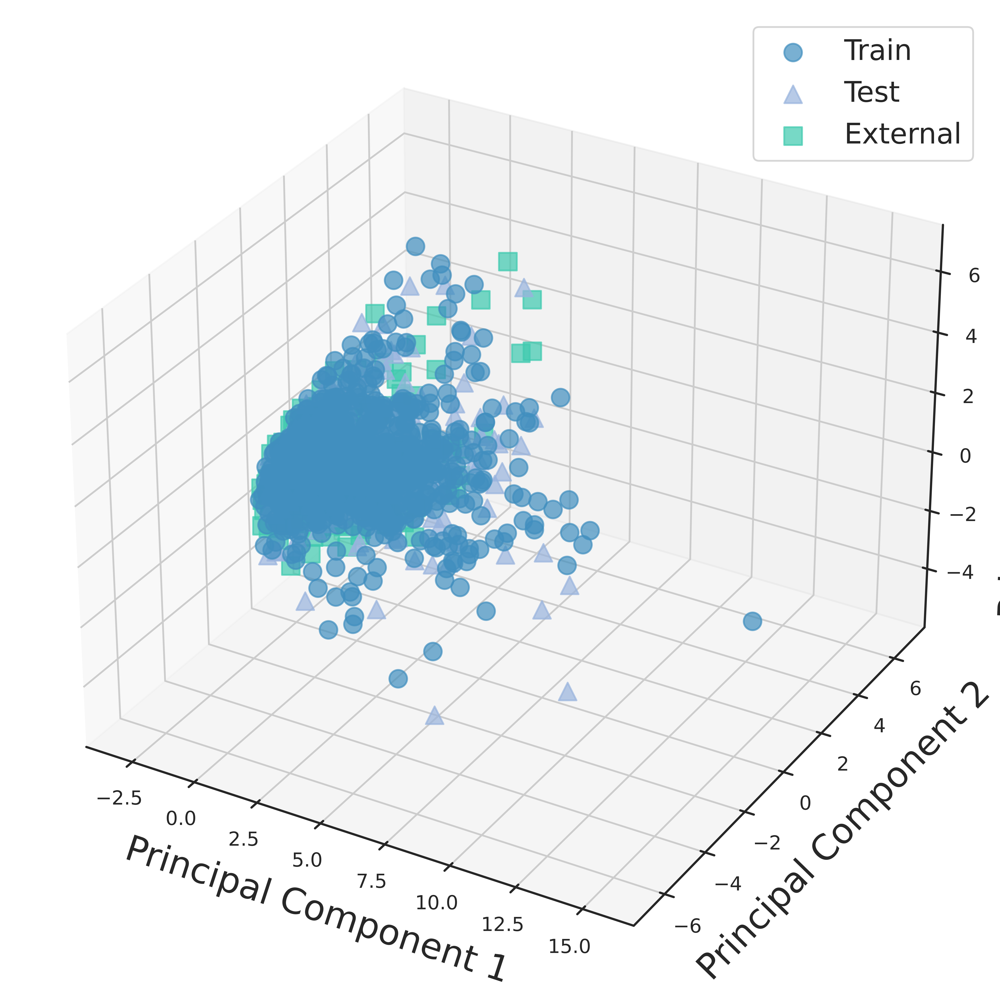

In [45]:
from rdkit import Chem
from rdkit.Chem import Descriptors, rdMolDescriptors
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

# 定义一个函数，计算一个分子的所有需要的描述符
def compute_descriptors(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles)
        if mol is None:  # 检查RDKit是否能够解析SMILES字符串
            raise ValueError(f"Could not parse SMILES: {smiles}")
        mw = Descriptors.MolWt(mol)
        logp = Descriptors.MolLogP(mol)
        psa = Descriptors.TPSA(mol)
        h_donors = Descriptors.NumHDonors(mol)
        h_acceptors = Descriptors.NumHAcceptors(mol)
        num_rings = Descriptors.RingCount(mol)
        num_aromatic_rings = Descriptors.NumAromaticRings(mol)
        num_rotatable_bonds = Descriptors.NumRotatableBonds(mol)
        tpsa = rdMolDescriptors.CalcTPSA(mol)
        num_stereocenters = len(Chem.FindMolChiralCenters(mol, includeUnassigned=True))
        return [mw, logp, psa, h_donors, h_acceptors, num_rings, num_aromatic_rings, num_rotatable_bonds, tpsa, num_stereocenters]
    except ValueError as e:
        print(e)
        return None  # 返回None，以便稍后可以从分析中排除这个分子

# 假设你有三个SMILES字符串列表：train_smiles, test_smiles, external_smiles
train_descriptors = [compute_descriptors(smile) for smile in train_smiles if compute_descriptors(smile) is not None]
test_descriptors = [compute_descriptors(smile) for smile in test_smiles if compute_descriptors(smile) is not None]
external_descriptors = [compute_descriptors(smile) for smile in external_smiles if compute_descriptors(smile) is not None]

# 过滤掉None值
train_descriptors = [desc for desc in train_descriptors if desc is not None]
test_descriptors = [desc for desc in test_descriptors if desc is not None]
external_descriptors = [desc for desc in external_descriptors if desc is not None]

# 将列表转换为NumPy数组
train_descriptors = np.array(train_descriptors)
test_descriptors = np.array(test_descriptors)
external_descriptors = np.array(external_descriptors)

# 数据标准化
scaler = StandardScaler()
train_descriptors = scaler.fit_transform(train_descriptors)
test_descriptors = scaler.transform(test_descriptors)
external_descriptors = scaler.transform(external_descriptors)

# 应用PCA
pca = PCA(n_components=3)
train_pca = pca.fit_transform(train_descriptors)
test_pca = pca.transform(test_descriptors)
external_pca = pca.transform(external_descriptors)

# 开始画图
fig = plt.figure(figsize=(10, 8), dpi=800)  # 使用高dpi保证图像质量
ax = fig.add_subplot(111, projection='3d')

ax.scatter(train_pca[:, 0], train_pca[:, 1], train_pca[:, 2], c='#418FBF', marker='o', alpha=0.7, label='Train',s=100)
ax.scatter(test_pca[:, 0], test_pca[:, 1], test_pca[:, 2], c='#99B4DE', marker='^', alpha=0.7, label='Test',s=100)
ax.scatter(external_pca[:, 0], external_pca[:, 1], external_pca[:, 2], c='#3ECAAF', marker='s', alpha=0.7, label='External',s=100)

# 设置标签
ax.set_xlabel('Principal Component 1', fontsize=20, labelpad=10)
ax.set_ylabel('Principal Component 2', fontsize=20, labelpad=10)
ax.set_zlabel('Principal Component 3', fontsize=20, labelpad=10)
# ax.set_title('PCA Analysis of Molecular Descriptors', fontsize=16, pad=20)

# 设置图例
ax.legend(fontsize=16)

# 显示图像
plt.tight_layout()
plt.show()
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/PCA_tte/PCA_Analysis_rabbit1.png',dpi=800,transparent=True)
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/PCA_tte/PCA_Analysis_rabbit1.svg')

### rat数据读取

In [46]:
a = pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/split/train_resample.csv')
b=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/split/test_dataset.csv')
c=pd.read_csv('/home/dell/mxq/toxic_mol/model/MS2/datasets/Rat/split/Rat_external.csv')
train_smiles=a['SMILES'].to_list()
test_smiles=b['Canonical_Smiles'].to_list()
external_smiles=c['Canonical_Smiles'].to_list()

[06:04:21] WARNING: not removing hydrogen atom without neighbors
[06:04:21] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:22] WARNING: not removing hydrogen atom without neighbors
[06:04:23] WARNING: not removing hydrogen atom without neighbors
[06:04:23] WARNING: not r

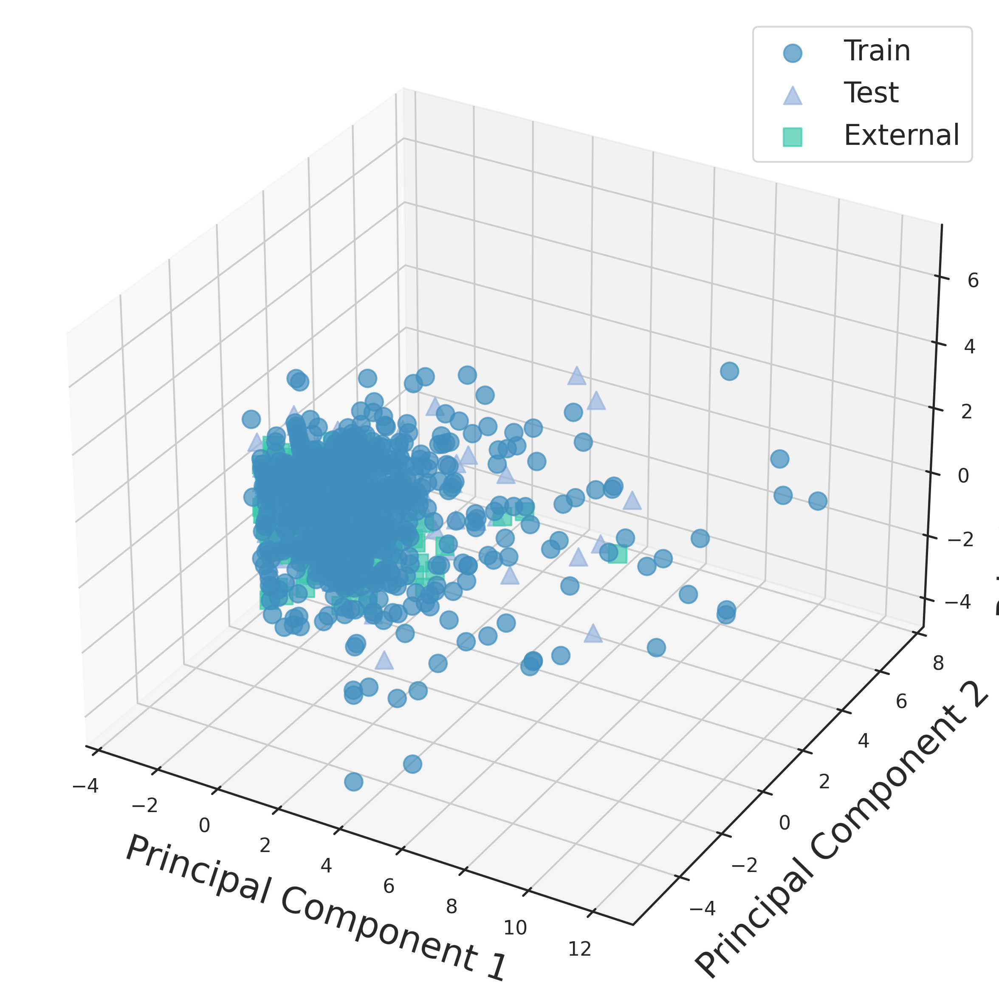

In [47]:
from rdkit import Chem
from rdkit.Chem import Descriptors, rdMolDescriptors
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

# 定义一个函数，计算一个分子的所有需要的描述符
def compute_descriptors(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles)
        if mol is None:  # 检查RDKit是否能够解析SMILES字符串
            raise ValueError(f"Could not parse SMILES: {smiles}")
        mw = Descriptors.MolWt(mol)
        logp = Descriptors.MolLogP(mol)
        psa = Descriptors.TPSA(mol)
        h_donors = Descriptors.NumHDonors(mol)
        h_acceptors = Descriptors.NumHAcceptors(mol)
        num_rings = Descriptors.RingCount(mol)
        num_aromatic_rings = Descriptors.NumAromaticRings(mol)
        num_rotatable_bonds = Descriptors.NumRotatableBonds(mol)
        tpsa = rdMolDescriptors.CalcTPSA(mol)
        num_stereocenters = len(Chem.FindMolChiralCenters(mol, includeUnassigned=True))
        return [mw, logp, psa, h_donors, h_acceptors, num_rings, num_aromatic_rings, num_rotatable_bonds, tpsa, num_stereocenters]
    except ValueError as e:
        print(e)
        return None  # 返回None，以便稍后可以从分析中排除这个分子

# 假设你有三个SMILES字符串列表：train_smiles, test_smiles, external_smiles
train_descriptors = [compute_descriptors(smile) for smile in train_smiles if compute_descriptors(smile) is not None]
test_descriptors = [compute_descriptors(smile) for smile in test_smiles if compute_descriptors(smile) is not None]
external_descriptors = [compute_descriptors(smile) for smile in external_smiles if compute_descriptors(smile) is not None]

# 过滤掉None值
train_descriptors = [desc for desc in train_descriptors if desc is not None]
test_descriptors = [desc for desc in test_descriptors if desc is not None]
external_descriptors = [desc for desc in external_descriptors if desc is not None]

# 将列表转换为NumPy数组
train_descriptors = np.array(train_descriptors)
test_descriptors = np.array(test_descriptors)
external_descriptors = np.array(external_descriptors)

# 数据标准化
scaler = StandardScaler()
train_descriptors = scaler.fit_transform(train_descriptors)
test_descriptors = scaler.transform(test_descriptors)
external_descriptors = scaler.transform(external_descriptors)

# 应用PCA
pca = PCA(n_components=3)
train_pca = pca.fit_transform(train_descriptors)
test_pca = pca.transform(test_descriptors)
external_pca = pca.transform(external_descriptors)

# 开始画图
fig = plt.figure(figsize=(10, 8), dpi=300)  # 使用高dpi保证图像质量
ax = fig.add_subplot(111, projection='3d')

ax.scatter(train_pca[:, 0], train_pca[:, 1], train_pca[:, 2], c='#418FBF', marker='o', alpha=0.7, label='Train',s=100)
ax.scatter(test_pca[:, 0], test_pca[:, 1], test_pca[:, 2], c='#99B4DE', marker='^', alpha=0.7, label='Test',s=100)
ax.scatter(external_pca[:, 0], external_pca[:, 1], external_pca[:, 2], c='#3ECAAF', marker='s', alpha=0.7, label='External',s=100)

# 设置标签
ax.set_xlabel('Principal Component 1', fontsize=20, labelpad=10)
ax.set_ylabel('Principal Component 2', fontsize=20, labelpad=10)
ax.set_zlabel('Principal Component 3', fontsize=20, labelpad=10)
# ax.set_title('PCA Analysis of Molecular Descriptors', fontsize=16, pad=20)

# 设置图例
ax.legend(fontsize=16)

# 显示图像
plt.tight_layout()
plt.show()
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/PCA_tte/PCA_Analysis_rat1.png',dpi=800,transparent=True)

### 10-fold heatmap

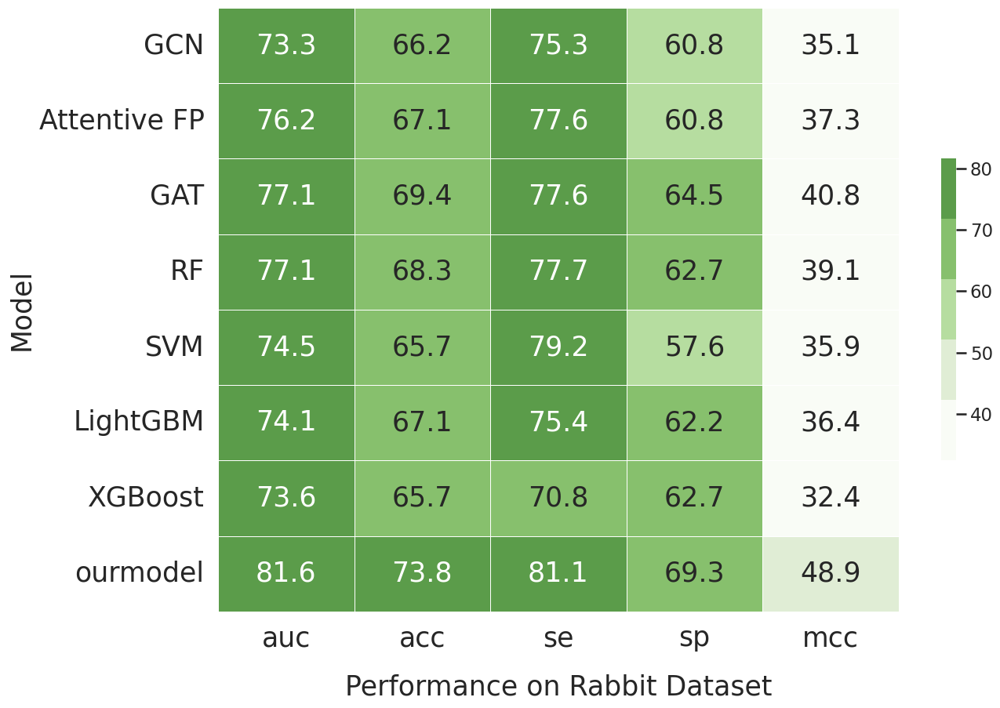

In [12]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 给出的数据
data = {
    "model": ["GCN", "Attentive FP", "GAT", "RF", "SVM", "LightGBM", "XGBoost", "ourmodel"],
    "auc": [73.3, 76.2, 77.1, 77.1, 74.5, 74.1, 73.6, 81.5909091],
    "acc": [66.2, 67.1, 69.4, 68.3, 65.7, 67.1, 65.7, 73.7752161],
    "se": [75.3, 77.6, 77.6, 77.7, 79.2, 75.4, 70.8, 81.0606061],
    "sp": [60.8, 60.8, 64.5, 62.7, 57.6, 62.2, 62.7, 69.3023256],
    "mcc": [35.1, 37.3, 40.8, 39.1, 35.9, 36.4, 32.4, 48.9012007]
}

# 创建DataFrame
df = pd.DataFrame(data)

# 设置索引为模型名称
df.set_index('model', inplace=True)

# 为了达到更高水平的图表美化，我们可以做以下几点：
# - 更改颜色映射以提供更好的视觉对比度
# - 增加清晰的标题和轴标签
# - 优化字体大小以提高清晰度
# - 移除坐标轴的边框线
# - 优化颜色条

# 设置字体大小
# 如果当前的蓝色太深，我们可以选择一个更亮的颜色映射。
# 这次我们将尝试 'BuGn' 色板，这是一个比 'YlGnBu' 更亮的蓝绿色调。
# 使用给定的十六进制颜色值创建自定义的颜色映射

custom_colors = ["#5B9C4A", "#87C06D","#B6DDA0","#E0EDD5" ,"#F9FCF6"]
# custom_colors = ["#005C88", "#026E89","#00837D","#019E69" ,"#B5CD01"]
custom_cmap = sns.color_palette(custom_colors[::-1])
# 设置风格
sns.set_context('talk')
sns.set_style("white")

# 绘制热力图
plt.figure(figsize=(14, 10))
heatmap = sns.heatmap(df, annot=True, fmt=".1f", linewidths=.5, cmap=custom_cmap, cbar_kws={'shrink': .5},annot_kws={"size": 25})

# 美化颜色条
cbar = heatmap.collections[0].colorbar
cbar.set_ticks([40, 50, 60, 70, 80])
cbar.set_ticklabels(['40', '50', '60', '70', '80'])

# 设置标题和轴标签
# plt.title('Performance Metrics Heatmap', fontsize=20, weight='bold')
plt.xlabel('Performance on Rabbit Dataset', fontsize=25,labelpad=20)
plt.ylabel('Model', fontsize=25)

# 设置字体风格为不粗体，更加优雅
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

# 移除坐标轴的边框线
# sns.despine()
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/htmap_rabbit.svg', format='svg', bbox_inches='tight')
# 导出为位图，可以使用PNG格式
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/htmap_rabbit.png', format='png', dpi=800, bbox_inches='tight',transparent=True)
# 展示图表
plt.show()


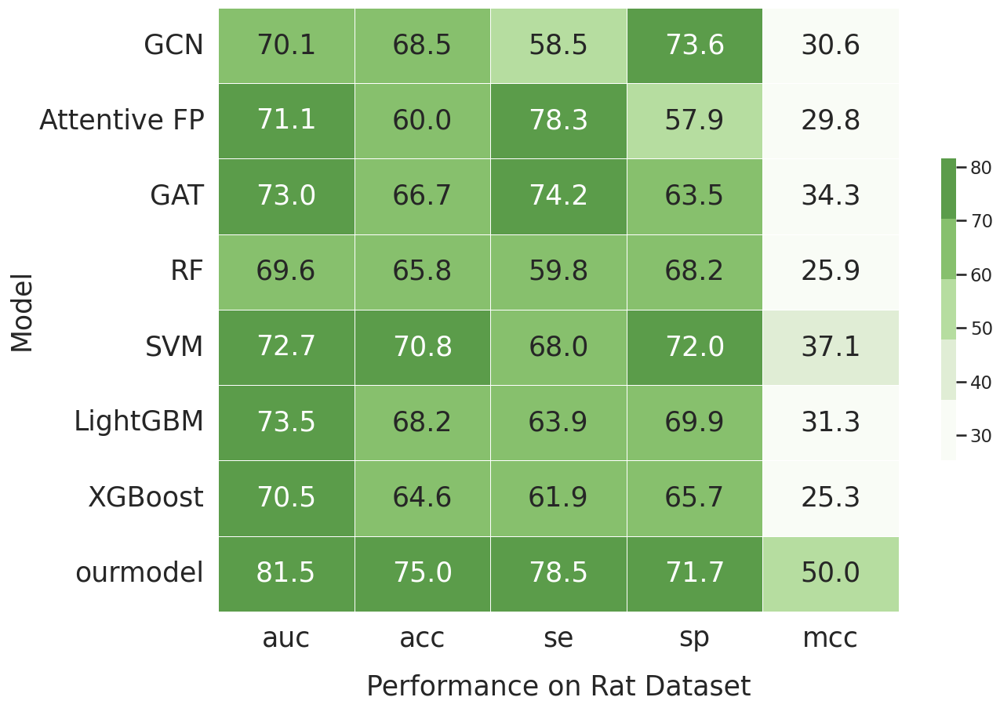

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 给出的数据
data = {
    "model": ["GCN", "Attentive FP", "GAT", "RF", "SVM", "LightGBM", "XGBoost", "ourmodel"],
    "auc": [70.1, 71.1, 73, 69.6, 72.7, 73.5, 70.5, 81.5],
    "acc": [68.5, 60, 66.7, 65.8, 70.8, 68.2, 64.6, 75],
    "se": [58.5, 78.3, 74.2, 59.8, 68, 63.9, 61.9, 78.5],
    "sp": [73.6, 57.9, 63.5, 68.2, 72, 69.9, 65.7, 71.7],
    "mcc": [30.6, 29.8, 34.3, 25.9, 37.1, 31.3, 25.3, 50]
}

# 创建DataFrame
df = pd.DataFrame(data)

# 设置索引为模型名称
df.set_index('model', inplace=True)

# 为了达到更高水平的图表美化，我们可以做以下几点：
# - 更改颜色映射以提供更好的视觉对比度
# - 增加清晰的标题和轴标签
# - 优化字体大小以提高清晰度
# - 移除坐标轴的边框线
# - 优化颜色条

# 设置字体大小
# 如果当前的蓝色太深，我们可以选择一个更亮的颜色映射。
# 这次我们将尝试 'BuGn' 色板，这是一个比 'YlGnBu' 更亮的蓝绿色调。
# 使用给定的十六进制颜色值创建自定义的颜色映射
# 设置全局字体为Arial

# custom_colors = ["#083A7A", "#0A549E", "#2272B6", "#3C8CC3", "#97C6DF", "#B2D2E8", "#CDDFF1", "#EBF3FB"]
custom_colors = ["#5B9C4A", "#87C06D","#B6DDA0","#E0EDD5" ,"#F9FCF6"]
custom_cmap = sns.color_palette(custom_colors[::-1])
# 设置风格
sns.set_context('talk')
sns.set_style("white")
# 绘制热力图
plt.figure(figsize=(14, 10))
heatmap = sns.heatmap(df, annot=True, fmt=".1f", linewidths=.5, cmap=custom_cmap, cbar_kws={'shrink': .5},annot_kws={"size": 25})

# # 美化颜色条
# cbar = heatmap.collections[0].colorbar
# cbar.set_ticks([40, 50, 60, 70, 80])
# cbar.set_ticklabels(['40', '50', '60', '70', '80'])

# 设置标题和轴标签
# plt.title('Performance Metrics Heatmap', fontsize=20, weight='bold')
plt.xlabel('Performance on Rat Dataset', fontsize=25,labelpad=20)
plt.ylabel('Model', fontsize=25)

# 设置字体风格为不粗体，更加优雅
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

# 移除坐标轴的边框线
# sns.despine()
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/htmap_rat1.svg', format='svg', bbox_inches='tight')
# 导出为位图，可以使用PNG格式
plt.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/htmap_rat1.png', format='png', dpi=300, bbox_inches='tight',transparent=True)
# 展示图表
plt.show()


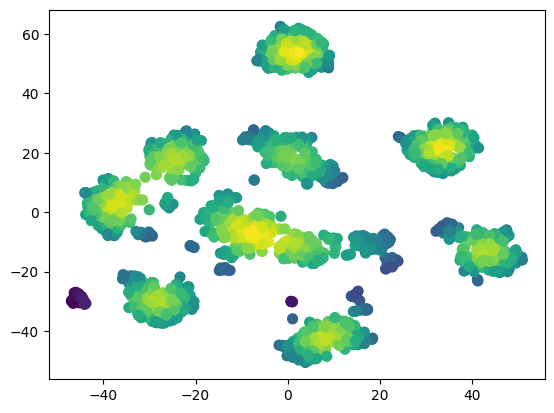

/home/dell/miniconda3/envs/mxq7/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 35282 (\N{CJK UNIFIED IDEOGRAPH-89D2}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/dell/miniconda3/envs/mxq7/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 24230 (\N{CJK UNIFIED IDEOGRAPH-5EA6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/dell/miniconda3/envs/mxq7/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 23494 (\N{CJK UNIFIED IDEOGRAPH-5BC6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/dell/miniconda3/envs/mxq7/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/dell/miniconda3/envs/mxq7/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 24067 (\N{CJK

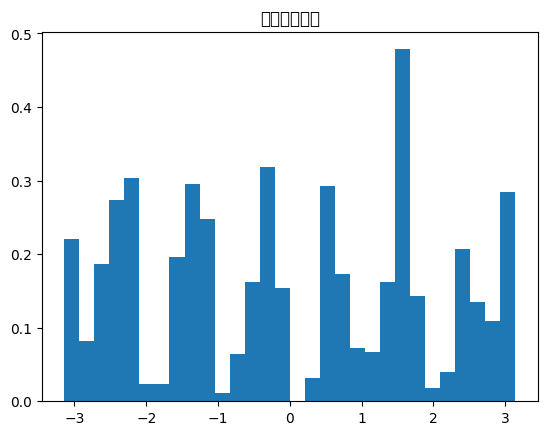

In [10]:
import numpy as np
from sklearn.manifold import TSNE
from sklearn.datasets import load_digits
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# 假设X是分子的数值表示矩阵，每行代表一个分子
# 这里我们使用手写数字数据集作为示例
X, y = load_digits(return_X_y=True)

# 使用t-SNE进行降维
X_embedded = TSNE(n_components=2, random_state=42).fit_transform(X)

# 对降维后的数据应用KDE
x = X_embedded[:, 0]
y = X_embedded[:, 1]
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)

# 计算并可视化角度的密度分布
theta = np.arctan2(y, x)
theta_density = gaussian_kde(theta)(theta)

# 可视化结果
fig, ax = plt.subplots()
ax.scatter(x, y, c=z, s=50, cmap='viridis')
plt.show()

# 角度密度分布可视化
plt.hist(theta, bins=30, density=True)
plt.title('角度密度分布')
plt.show()


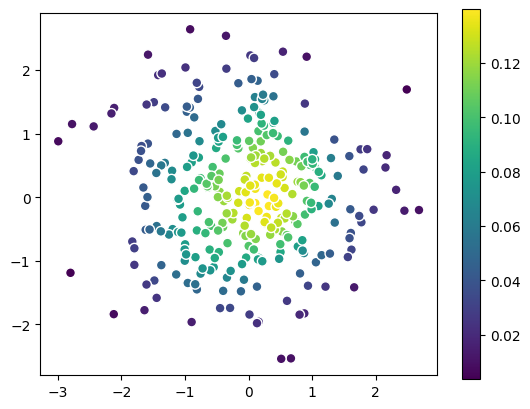

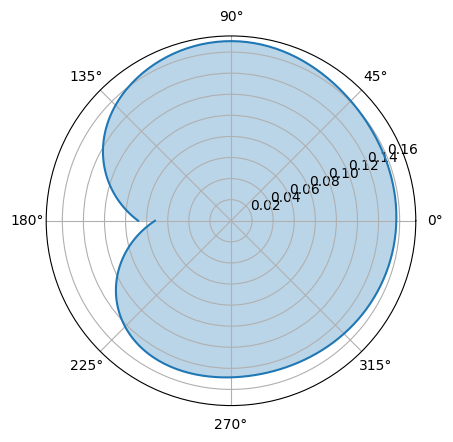

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# 生成示例数据
X_embedded = np.random.randn(300, 2)  # 替换为你的t-SNE处理后的数据

# 计算每个点的KDE
xy = np.vstack([X_embedded[:, 0], X_embedded[:, 1]])
z = gaussian_kde(xy)(xy)

# 二维空间中的密度分布
fig, ax = plt.subplots()
scatter = ax.scatter(X_embedded[:, 0], X_embedded[:, 1], c=z, s=50, cmap='viridis', edgecolor='white')
plt.colorbar(scatter, ax=ax)
ax.set_aspect('equal')
plt.show()

# 计算角度并展示其KDE
theta = np.arctan2(X_embedded[:, 1], X_embedded[:, 0])
theta_kde = gaussian_kde(theta)
theta_values = np.linspace(-np.pi, np.pi, 300)
theta_density = theta_kde(theta_values)

# 角度的密度分布
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta_values, theta_density)
ax.fill(theta_values, theta_density, alpha=0.3)
plt.show()


###ab study for rat

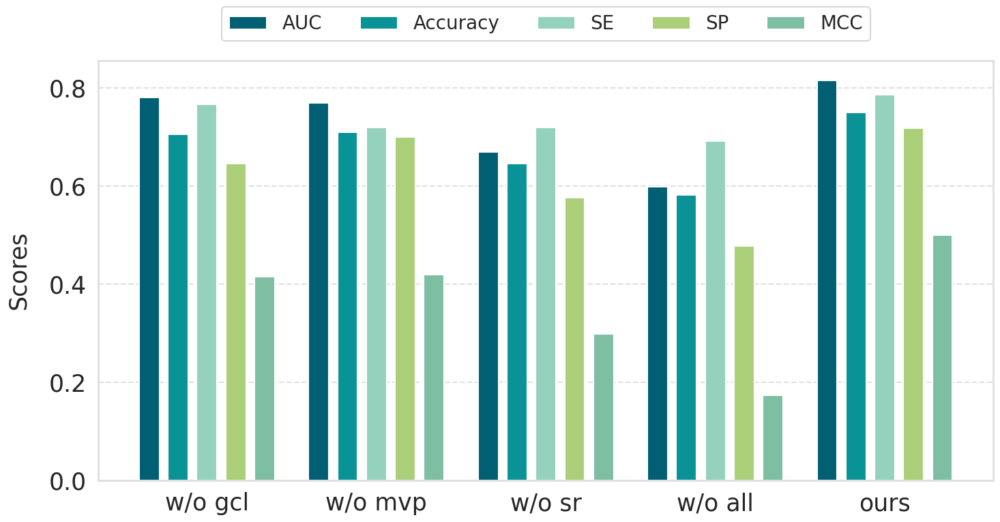

In [104]:
import numpy as np
import matplotlib.pyplot as plt

# Provided data
methods = ['w/o gcl', 'w/o mvp', 'w/o sr', 'w/o all', 'ours']
auc = [0.7800016541229013, 0.768671, 0.668927301, 0.598214, 0.815]
accuracy = [0.7045454545454546, 0.709091, 0.645454545, 0.581818, 0.75]
se = [0.7663551401869159, 0.719626, 0.719626168, 0.691589, 0.785]
sp = [0.6460176991150443, 0.699115, 0.575221239, 0.477876, 0.717]
mcc = [0.4146944378836145, 0.418603, 0.297516882, 0.173231, 0.5]

# Set up for plotting
x = np.arange(len(methods))  # the label locations

## Let's choose a new palette based on the user's preference for shades of blue and green.

# New color palette - shades of blue and green
blue_green_palette = ['#005f73', '#0a9396', '#94d2bd', '#AACF78', '#7EBEA3']
# Generate bar plots for each metric with spacing within groups
new_width = 0.12

# Gap size between bars within a group
gap = 0.05

# Create a bar plot with spacing within each group
fig, ax = plt.subplots(figsize=(15, 8))  # Keeping the figure size large for readability
offset_multiplier = new_width + gap
# Generate bar plots for each metric with spacing within groups
# Adjust the x positions to create gaps between bars within a group
rects1 = ax.bar(x - 2 * offset_multiplier, auc, new_width, label='AUC', color=blue_green_palette[0])
rects2 = ax.bar(x - 1 * offset_multiplier, accuracy, new_width, label='Accuracy', color=blue_green_palette[1])
rects3 = ax.bar(x, se, new_width, label='SE', color=blue_green_palette[2])
rects4 = ax.bar(x + 1 * offset_multiplier, sp, new_width, label='SP', color=blue_green_palette[3])
rects5 = ax.bar(x + 2 * offset_multiplier, mcc, new_width, label='MCC', color=blue_green_palette[4])


# Adding value labels on top of the bars
def add_value_labels(ax, spacing=5):
    """Add labels to the end of each bar in a bar chart."""
    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        va = 'bottom'  # Vertical alignment for positive values

        # If the value of a bar is negative: Place label below bar
        if y_value < 0:
            space *= -1
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.2f}".format(y_value)

        # Create annotation
        ax.annotate(
            label,                      # Use `label` as label
            (x_value, y_value),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va,fontsize=25)                      # Vertically align label differently for
                                        # positive and negative values.

# Call the function above to add labels
# add_value_labels(ax)
# Same settings for labels, legend, spines, background, grid, and tick labels rotation
ax.set_ylabel('Scores', fontsize=25,labelpad=20)
ax.set_xticks(x)
ax.set_xticklabels(methods)
# ax.set_xlabel('Methods', fontsize=20)
ax.legend(ncol=5, loc='upper center', bbox_to_anchor=(0.5, 1.15), fontsize=20)
for spine in ax.spines.values():
    spine.set_color('#dddddd')
ax.set_facecolor('white')
# fig.patch.set_facecolor('#f0f0f0')
ax.yaxis.grid(True, linestyle='--', which='major', color='grey', alpha=.25)
ax.tick_params(labelsize=25)
# plt.setp(ax.get_xticklabels())
plt.tight_layout()

# Display the plot
plt.show()
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/ab_for_rat1.svg', format='svg', bbox_inches='tight')
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/ab_for_rat1.png', dpi=1000, bbox_inches='tight',transparent=True)




ab stduy for rabbit

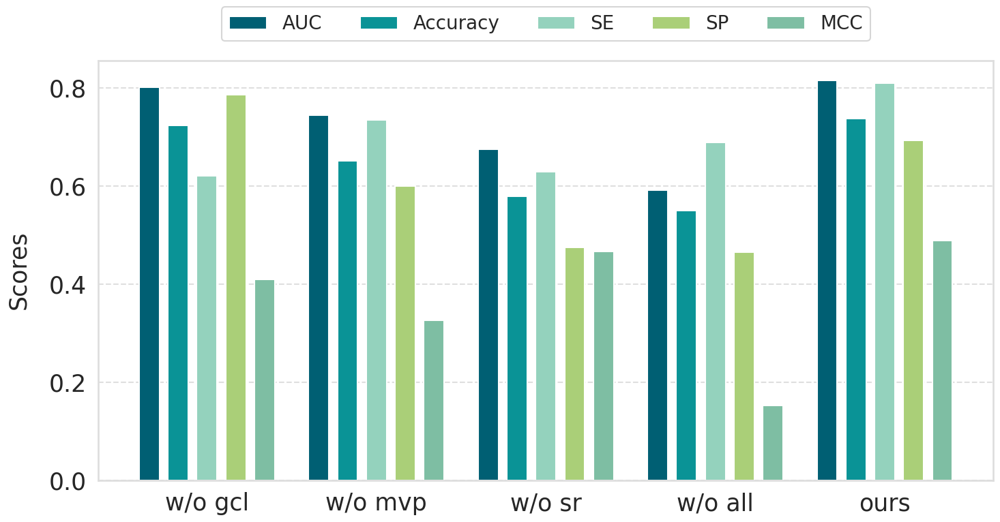

In [105]:
# I will review the code snippet provided by the user and make improvements for better visualization.

import numpy as np
import matplotlib.pyplot as plt
# auc = [0.801761804, 0.802396054, 0.674982, 0.591966173, 0.815909091]
# accuracy = [0.723342939, 0.746397695, 0.752161, 0.550432277, 0.737752161]
# se = [0.621212121, 0.757575758, 0.628788, 0.689393939, 0.810606061]
# sp = [0.786046512, 0.739534884, 0.827907, 0.465116279, 0.693023256]
# mcc = [0.409778768, 0.485154733, 0.46615, 0.152728552, 0.489012007]
# Provided data
methods = ['w/o gcl', 'w/o mvp', 'w/o sr', 'w/o all', 'ours']
auc = [0.801761804, 0.745349, 0.674982, 0.591966173, 0.815909091]
accuracy = [0.723342939, 0.651297, 0.579250720461095, 0.550432277, 0.737752161]
se = [0.621212121, 0.734848, 0.628788, 0.689393939, 0.810606061]
sp = [0.786046512, 0.6, 0.4744186046511628, 0.465116279, 0.693023256]
mcc = [0.409778768, 0.325617, 0.46615, 0.152728552, 0.489012007]
# Set up for plotting
x = np.arange(len(methods))  # the label locations

## Let's choose a new palette based on the user's preference for shades of blue and green.

# New color palette - shades of blue and green
blue_green_palette = ['#005f73', '#0a9396', '#94d2bd', '#AACF78', '#7EBEA3']
# Generate bar plots for each metric with spacing within groups
new_width = 0.12

# Gap size between bars within a group
gap = 0.05

# Create a bar plot with spacing within each group
fig, ax = plt.subplots(figsize=(15, 8))  # Keeping the figure size large for readability
offset_multiplier = new_width + gap
# Generate bar plots for each metric with spacing within groups
# Adjust the x positions to create gaps between bars within a group
rects1 = ax.bar(x - 2 * offset_multiplier, auc, new_width, label='AUC', color=blue_green_palette[0])
rects2 = ax.bar(x - 1 * offset_multiplier, accuracy, new_width, label='Accuracy', color=blue_green_palette[1])
rects3 = ax.bar(x, se, new_width, label='SE', color=blue_green_palette[2])
rects4 = ax.bar(x + 1 * offset_multiplier, sp, new_width, label='SP', color=blue_green_palette[3])
rects5 = ax.bar(x + 2 * offset_multiplier, mcc, new_width, label='MCC', color=blue_green_palette[4])


# Adding value labels on top of the bars
def add_value_labels(ax, spacing=5):
    """Add labels to the end of each bar in a bar chart."""
    for rect in ax.patches:
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        va = 'bottom'  # Vertical alignment for positive values

        # If the value of a bar is negative: Place label below bar
        if y_value < 0:
            space *= -1
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.2f}".format(y_value)

        # Create annotation
        ax.annotate(
            label,                      # Use `label` as label
            (x_value, y_value),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va,fontsize=25)                      # Vertically align label differently for
                                        # positive and negative values.

# Call the function above to add labels
# add_value_labels(ax)
# Same settings for labels, legend, spines, background, grid, and tick labels rotation
ax.set_ylabel('Scores', fontsize=25,labelpad=20)
ax.set_xticks(x)
# ax.set_xticklabels(methods, fontsize=25)
ax.set_xticklabels(methods, fontsize=20)  # Set font size here
# ax.set_xlabel('Methods', fontsize=20)
ax.legend(ncol=5, loc='upper center', bbox_to_anchor=(0.5, 1.15), fontsize=20)
for spine in ax.spines.values():
    spine.set_color('#dddddd')
ax.set_facecolor('white')
# fig.patch.set_facecolor('#f0f0f0')
ax.yaxis.grid(True, linestyle='--', which='major', color='grey', alpha=.25)
ax.tick_params(labelsize=25)
# plt.setp(ax.get_xticklabels())
plt.tight_layout()

# Display the plot
plt.show()
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/ab_for_rabbit.svg', format='svg', bbox_inches='tight')
fig.savefig('/home/dell/mxq/toxic_mol/model/MS2/ana/exp/ab_for_rabbit.png', dpi=1000, bbox_inches='tight',transparent=True)

#### 外部测试集 柱状图

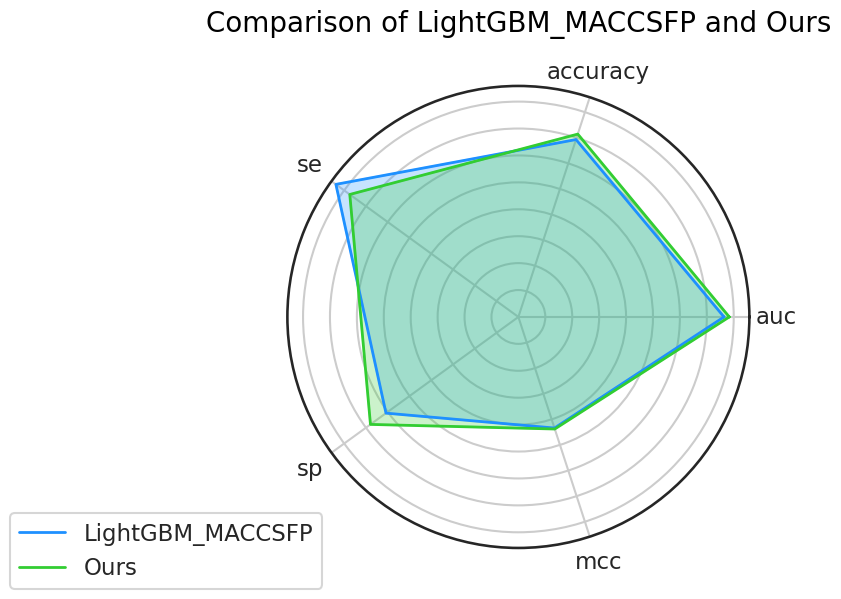

In [78]:
def create_comparison_radar_chart(data1, data2, labels, colors):
    # Number of variables we're plotting.
    num_vars = len(labels)

    # Split the circle into even parts and save angles so we know where to put each axis.
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

    # The radar chart is a circle, so we need to complete the loop and make the graph aesthetically pleasing.
    data1 = np.concatenate((data1,[data1[0]]))
    data2 = np.concatenate((data2,[data2[0]]))
    angles += angles[:1]

    # Draw the plot
    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.fill(angles, data1, color=colors[0], alpha=0.25)
    ax.plot(angles, data1, color=colors[0], linewidth=2, label='LightGBM_MACCSFP')  # Line width
    ax.fill(angles, data2, color=colors[1], alpha=0.25)
    ax.plot(angles, data2, color=colors[1], linewidth=2, label='Ours')
    ax.set_yticklabels([])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)

    # Add legend and title
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    plt.title('Comparison of LightGBM_MACCSFP and Ours', size=20, color='black', y=1.1)

    return plt

# Sample data for LightGBM_MACCSFP and ours
data_lightgbm = [76.4, 69.3, 83.8, 60.8, 43.4]
data_ours = [78.351339, 71.4285714, 77.4193548, 67.9245283, 43.7735062]
labels = ['auc', 'accuracy', 'se', 'sp', 'mcc']
colors = ['#1e90ff', '#32cd32']  # Blue for LightGBM_MACCSFP and Green for Ours

# Create radar chart
radar_chart_comparison = create_comparison_radar_chart(data_lightgbm, data_ours, labels, colors)
radar_chart_comparison.show()

'/home/dell/mxq/toxic_mol/model/MS2/ana/exp/radar_chartrabbit.png'

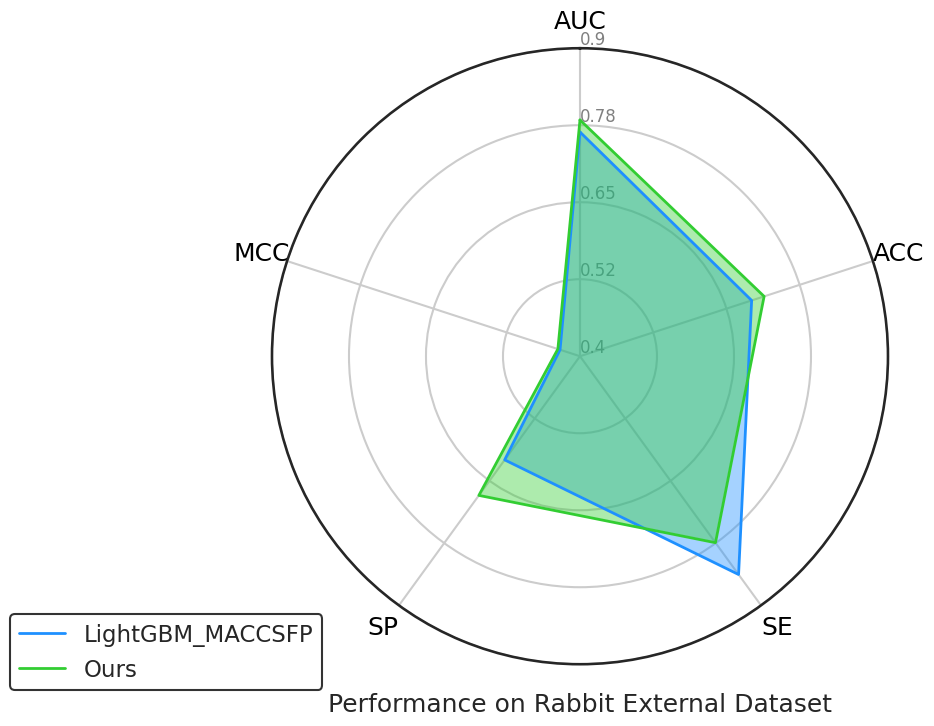

In [111]:
# To make the differences between the objects more noticeable, let's try a different approach.
# We will adjust the r-axis range to be closer to the data values, which can help amplify the differences.
data_lightgbm = [0.764, 0.693, 0.838, 0.608, 0.434]
data_ours = [0.78351339, 0.714285714, 0.774193548, 0.679245283, 0.437735062]
import matplotlib.pyplot as plt
import numpy as np
labels = ['AUC', 'ACC', 'SE', 'SP', 'MCC']
colors = ['#1e90ff', '#32cd32']  # Blue for LightGBM_MACCSFP and Green for Ours
# Define the missing function to determine the r-axis range based on both data sets
def determine_scale_range(data1, data2):
    combined_data = np.concatenate((data1, data2))
    lower_bound = np.floor(min(combined_data) * 10) / 10  # Floor to nearest tenth
    upper_bound = np.ceil(max(combined_data) * 10) / 10   # Ceil to nearest tenth
    return lower_bound, upper_bound

# Redefine the function for creating the radar chart with the updated data and requirements
def create_comparison_radar_chart_custom_axis(data1, data2, labels, colors, r_axis_lower, r_axis_upper):
    # Number of variables we're plotting.
    num_vars = len(labels)

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist() # Close the loop
    angles += angles[:1]

    # The plot is made circular, so we need to "complete the loop" and append the start to the end.
    data1 = np.concatenate((data1, [data1[0]]))
    data2 = np.concatenate((data2, [data2[0]]))
    
    # Set up the figure
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    ax.set_theta_offset(np.pi / 2) # Set the start of the graph at the top
    ax.set_theta_direction(-1) # The angles go counterclockwise

    # Draw one axe per variable and add labels
    plt.xticks(angles[:-1], labels, color='black', size=18)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks(np.linspace(r_axis_lower, r_axis_upper, 5), 
               [str(round(label, 2)) for label in np.linspace(r_axis_lower, r_axis_upper, 5)], 
               color='grey', size=12)
    plt.ylim(r_axis_lower, r_axis_upper)

    # Plot data and fill with color
    ax.plot(angles, data1, colors[0], linewidth=2, linestyle='solid', label='LightGBM_MACCSFP')
    ax.fill(angles, data1, colors[0], alpha=0.4)
    
    ax.plot(angles, data2, colors[1], linewidth=2, linestyle='solid', label='Ours')
    ax.fill(angles, data2, colors[1], alpha=0.4)

    # Add a legend with some customizations.
    legend = ax.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    frame = legend.get_frame()
    frame.set_facecolor('white')
    frame.set_edgecolor('black')
    plt.xlabel('Performance on Rabbit External Dataset', size=18,labelpad=20)
    # Title the plot
    return plt

# Now we will use the function to determine the r-axis range
r_axis_lower, r_axis_upper = determine_scale_range(np.array(data_lightgbm), np.array(data_ours))

# Create and show the improved radar chart with the updated data
radar_chart_custom_axis = create_comparison_radar_chart_custom_axis(
    data_lightgbm, data_ours, labels, colors, r_axis_lower, r_axis_upper
)
# Uncomment the below line when we want to show the plot in the PCI
# radar_chart_custom_axis.show()

# Define the function for saving the plot with high DPI, which we will call after user confirmation.
def save_high_dpi_radar_chart(plt, filename):
    file_path = f'/home/dell/mxq/toxic_mol/model/MS2/ana/exp/'+filename
    plt.savefig(file_path, dpi=1000, format='png', bbox_inches='tight',transparent=True)
    return file_path

# The line to save the plot will be uncommented after user confirmation
save_high_dpi_radar_chart(radar_chart_custom_axis, "radar_chartrabbit.png")


'/home/dell/mxq/toxic_mol/model/MS2/ana/exp/radar_chartrat.png'

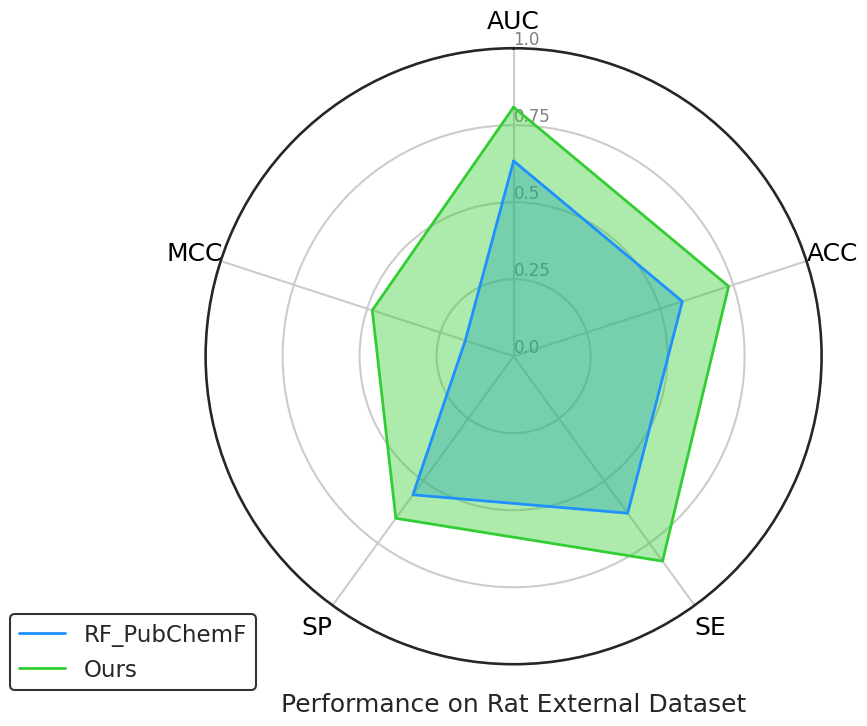

In [112]:
import matplotlib.pyplot as plt
import numpy as np

# User-provided data
data_lightgbm = [0.634, 0.576, 0.630, 0.556, 0.165]
data_ours = [0.808576627, 0.734090909, 0.822429907, 0.650442478, 0.482574866]
labels = ['AUC', 'ACC', 'SE', 'SP', 'MCC']
colors = ['#1e90ff', '#32cd32']  # Blue for LightGBM_MACCSFP and Green for Ours

# Adjust the r-axis range to be closer to the data values
r_axis_lower, r_axis_upper = np.floor(min(data_lightgbm + data_ours)), np.ceil(max(data_lightgbm + data_ours))

# Function to create an improved radar chart
def create_improved_radar_chart(data1, data2, labels, colors, r_axis_lower, r_axis_upper):
    # Number of variables we're plotting.
    num_vars = len(labels)

    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist() # Close the loop
    angles += angles[:1]

    # The plot is made circular, so we need to "complete the loop" and append the start to the end.
    data1 = np.concatenate((data1, [data1[0]]))
    data2 = np.concatenate((data2, [data2[0]]))
    
    # Set up the figure
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    ax.set_theta_offset(np.pi / 2) # Set the start of the graph at the top
    ax.set_theta_direction(-1) # The angles go counterclockwise

    # Draw one axe per variable and add labels
    plt.xticks(angles[:-1], labels, color='black', size=18)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks(np.linspace(r_axis_lower, r_axis_upper, 5), 
               [str(round(label, 2)) for label in np.linspace(r_axis_lower, r_axis_upper, 5)], 
               color='grey', size=12)
    plt.ylim(r_axis_lower, r_axis_upper)

    # Plot data and fill with color
    ax.plot(angles, data1, colors[0], linewidth=2, linestyle='solid', label='RF_PubChemF')
    ax.fill(angles, data1, colors[0], alpha=0.4)
    
    ax.plot(angles, data2, colors[1], linewidth=2, linestyle='solid', label='Ours')
    ax.fill(angles, data2, colors[1], alpha=0.4)

    # Add a legend with some customizations.
    legend = ax.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    frame = legend.get_frame()
    frame.set_facecolor('white')
    frame.set_edgecolor('black')

    # Title the plot
    # plt.title('Performance on Rat External Dataset', size=18, color='black', y=1.1)
    plt.xlabel('Performance on Rat External Dataset', size=18,labelpad=20)
    return plt

# Create and show the improved radar chart
radar_chart_improved = create_improved_radar_chart(data_lightgbm, data_ours, labels, colors, r_axis_lower, r_axis_upper)
# We will comment out the plot display command before running the code in the PCI
# radar_chart_improved.show()
# Save the improved radar chart as a high DPI PNG file
file_path = '/home/dell/mxq/toxic_mol/model/MS2/ana/exp/radar_chartrat.png'
# Save the figure   
radar_chart_improved.savefig(file_path, dpi=1000, format='png', bbox_inches='tight',transparent=True)
# Provide the path for the user to download
file_path
